gene expression: normalise + logtransform

# Import modules

In [1]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

import numpy as np
import numpy.random as random
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
import anndata


import celltypist
from celltypist import models

import sctk
import os

In [2]:
import session_info
session_info.show()

In [3]:
sc.settings.set_figure_params(dpi=120, facecolor='white', color_map = 'RdPu',)

# Function

In [4]:
#>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>
# extract rank_genes_groups result 
#>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>

import scanpy as sc
import pandas as pd

def rank_genes_groups_to_df(adata, cell):
    
    dic = adata.uns['rank_genes_groups'] 
    
    df = pd.DataFrame({
        'names' : dic['names'][cell],
        'scores' : dic['scores'][cell],
        'pvals' : dic['pvals'][cell],
        'pvals_adj' : dic['pvals_adj'][cell],
        'logfoldchanges' : dic['logfoldchanges'][cell]
    })
    
    return df

# Read in data

In [14]:
compartment = 'Lymphoid'

In [15]:
adata = sc.read_h5ad(f'/home/jovyan/mount/gdrive/Colab/data/scVI/subsets/RNA_foetal_{compartment}_post-scVI_16Feb2023.h5ad')
adata

AnnData object with n_obs × n_vars = 21336 × 28811
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'sangerID', 'combinedID', 'donor', 'donor_type', 'region', 'region_finest', 'age', 'gender', 'facility', 'cell_or_nuclei', 'modality', 'kit_10x', 'flushed', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'n_genes', 'n_counts', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'HB_score', 'donor_by_library-prep', 'multiplexed', 'SOC | status', 'SOC | log_prob_singleton', 'SOC | log_prob_doublet', 'batch_key', '_scvi_batch', '_scvi_labels', '2Jan_coarse_grain', '2Jan_mid_grain', '2Jan_fine_grain', 'leiden_scVI', 'FACSgate', 'sex', 'week', 'trimester', 'cell_type2'
    var: 'gene_name_scRNA-0', 'gene_id', 'n_cells'
    uns: '_scvi_manager_uuid', '_scvi_

# Log-normalise

In [7]:
# normalise and logtransform
# adata.raw = adata
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

# Clustering, UMAP

### Deciding resolution

In [ ]:
%%time

sc.pp.neighbors(adata, use_rep="X_scVI")
sc.tl.umap(adata, min_dist=0.2, spread=1.0, n_components=3)

resolutions = [0.2,0.3,0.4,0.5,0.6,] # 0.7,0.8,0.9,1.0
for res in resolutions:
    print(res)
    sc.tl.leiden(adata, resolution=res, key_added=f'leiden_scVI_{res}')
    sc.pl.umap(adata, color=[f'leiden_scVI_{res}'], size=5, components='all', wspace=0.5)

In [8]:
sc.pp.neighbors(adata, use_rep="X_scVI")
sc.tl.umap(adata, min_dist=0.2, spread=1.0, n_components=3)
sc.tl.leiden(adata, resolution=1, key_added='leiden_scVI')

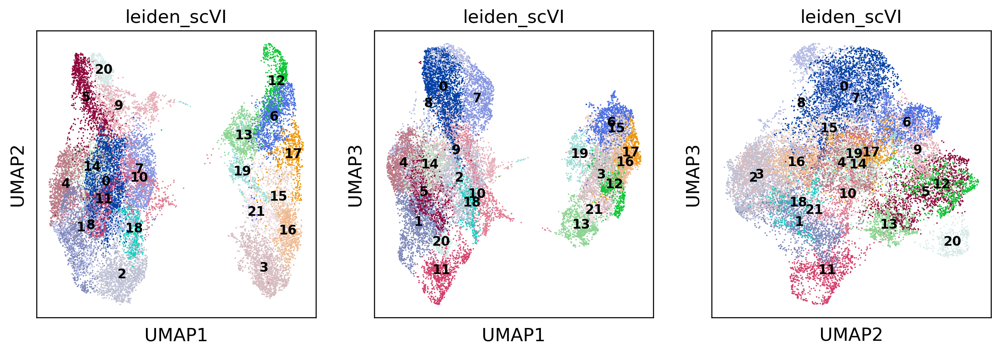

In [15]:
sc.pl.umap(adata, color=['leiden_scVI'], size=5, wspace=0.1, legend_loc='on data', legend_fontsize=10,components='all')

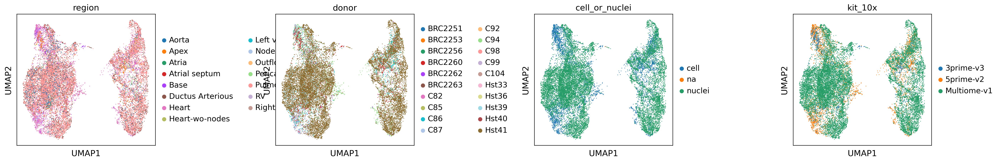

In [16]:
sc.pl.umap(adata, color=['region','donor','cell_or_nuclei','kit_10x'], size=5, wspace=0.7)

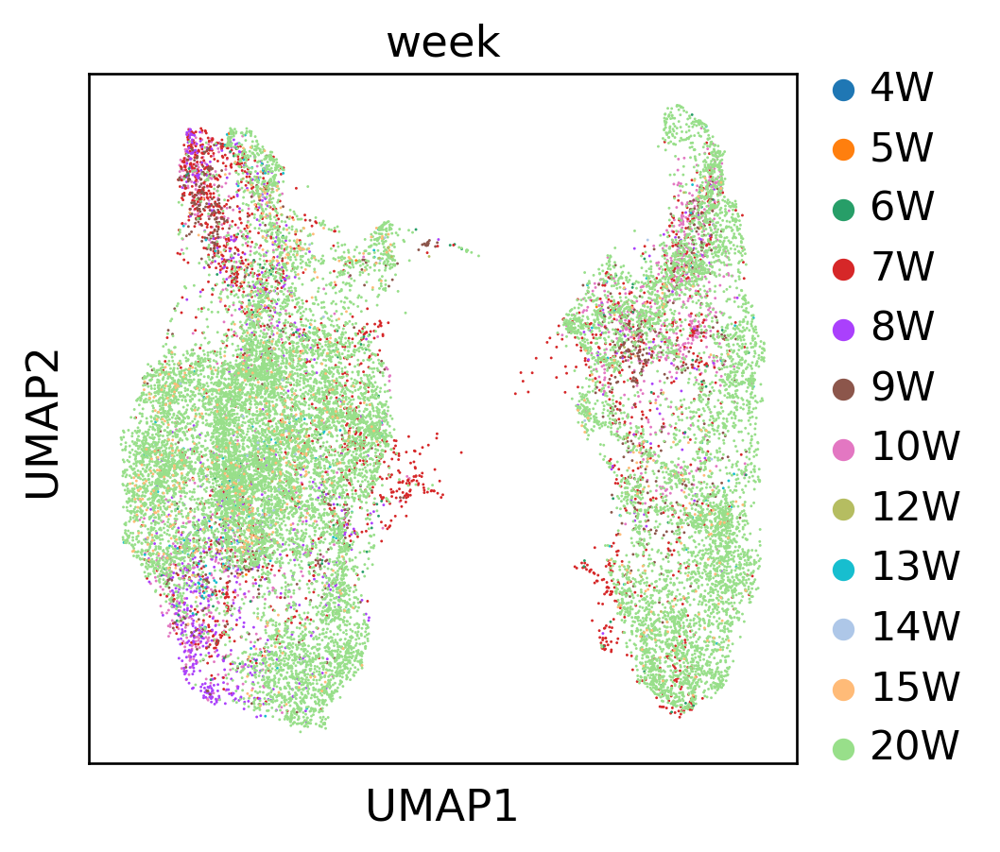

In [17]:
sc.pl.umap(adata, color=['week'], size=3, wspace=0.5)

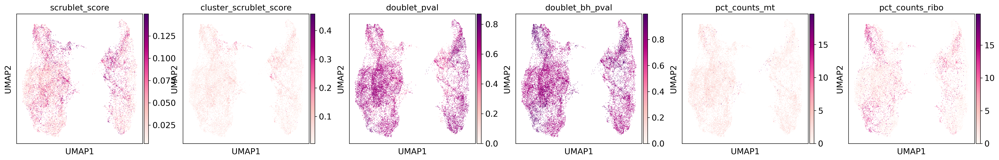

In [18]:
sc.pl.umap(adata, color=['scrublet_score','cluster_scrublet_score','doublet_pval','doublet_bh_pval','pct_counts_mt','pct_counts_ribo'], size=2, wspace=0.2, ncols=6)

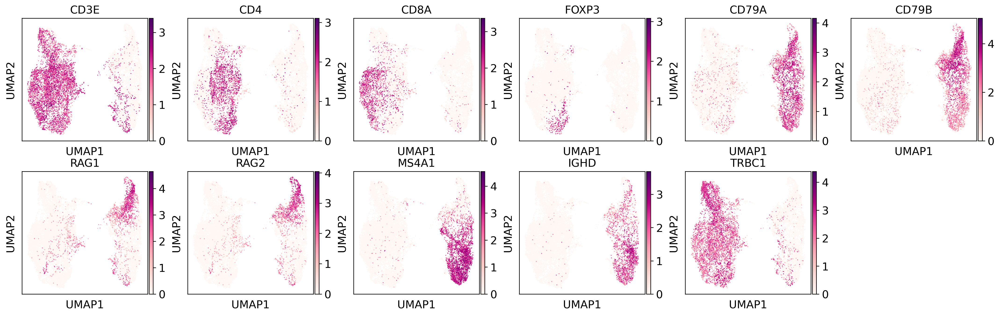

In [77]:
stress_genes=['CD3E','CD4','CD8A','FOXP3','CD79A','CD79B','RAG1','RAG2','MS4A1','IGHD','TRBC1']
stress_genes = [x for x in stress_genes if x in adata.var_names]
sc.pl.umap(adata, color=stress_genes, size=5, wspace=0.2, ncols=6)

# Marker gene expressions

categories: 0, 1, 2, etc.
var_group_labels: vCM, aCM, FB, etc.


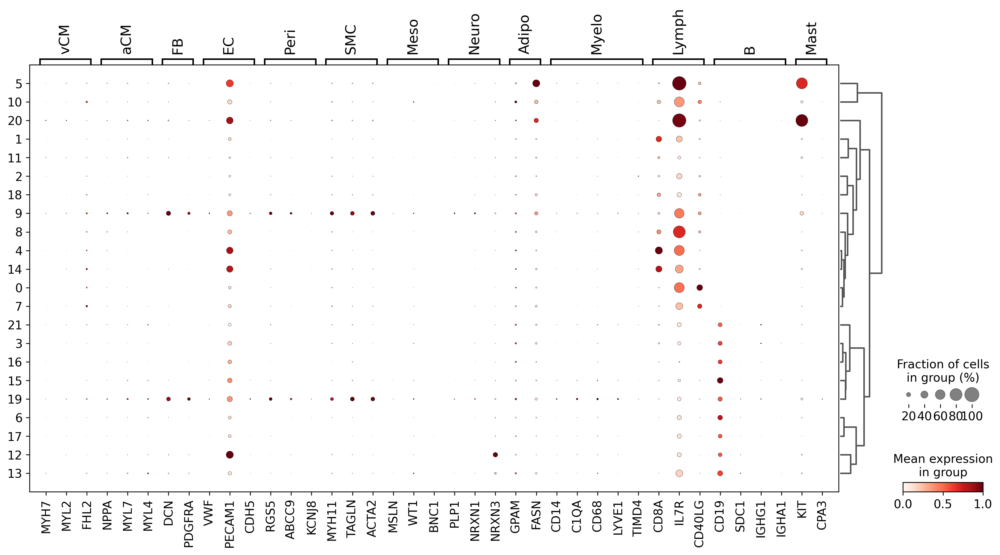

In [20]:
# Checking glabal markers
markers = {
    'vCM': ['MYH7', 'MYL2', 'FHL2'],
    'aCM': ['NPPA', 'MYL7', 'MYL4'],
    'FB': ['DCN', 'GCN', 'PDGFRA'],
    'EC': ['VWF', 'PECAM1', 'CDH5'],
    'Peri': ['RGS5', 'ABCC9', 'KCNJ8'],
    'SMC': ['MYH11', 'TAGLN', 'ACTA2'],
    'Meso': ['MSLN', 'WT1', 'BNC1'],
    'Neuro': ['PLP1', 'NRXN1', 'NRXN3'],
    'Adipo': ['GPAM', 'FASN', 'LEP'],
    'Myelo': ['CD14', 'C1QA', 'CD68','LYVE1','TIMD4'],
    'Lymph': ['CD8A', 'IL7R', 'CD40LG'],
    'B': ['CD19','SDC1','IGHG1','IGHA1'],
    'Mast': ['KIT', 'CPA3'],
}

for key in markers.keys():
    markers[key]=[x for x in markers[key] if x in adata.var_names]

sc.tl.dendrogram(adata, groupby='leiden_scVI')
sc.pl.dotplot(adata,
              markers, 
              groupby='leiden_scVI',
              dendrogram=True,
              standard_scale="var",
              color_map="Reds",
              # swap_axes=True,
             )

categories: 0, 1, 2, etc.
var_group_labels: B cell, T cell, naive, etc.


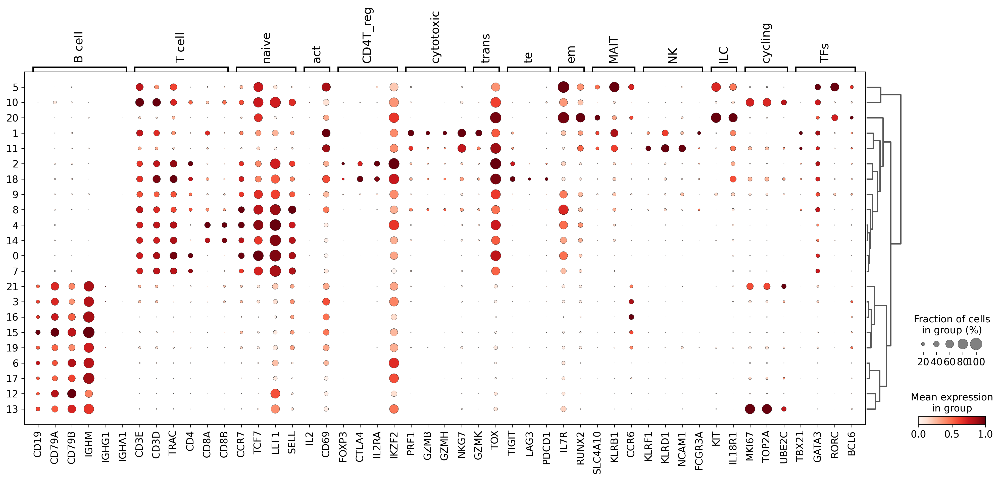

In [21]:
# lymphocytes markers

markers={
    'B cell': ['CD19', 'CD79A', 'CD79B', 'IGHM', 'IGHG1', 'IGHA1'],
    'T cell': ['CD3E', 'CD3D', 'TRAC', 'CD4', 'CD8A', 'CD8B'],
    'naive': ['CCR7', 'TCF7', 'LEF1', 'SELL'],
    'act': ['IL2','CD69'],
    'CD4T_reg': ['FOXP3', 'CTLA4', 'IL2RA', 'IKZF2'],
    'cytotoxic': ['PRF1', 'GZMB', 'GZMH', 'NKG7'],
    'trans': ['GZMK', 'TOX'],
    'te': ['TIGIT', 'LAG3', 'PDCD1'],
    'em': ['IL7R', 'RUNX2'],
    'MAIT': ['SLC4A10', 'KLRB1', 'CCR6'],
    'NK': ['KLRF1', 'KLRD1', 'NCAM1', 'FCGR3A'],
    'ILC': ['KIT', 'IL18R1'],
    'cycling': ['MKI67', 'TOP2A', 'UBE2C'],
    'TFs': ['TBX21', 'GATA3', 'RORC', 'BCL6',],
}


for key in markers.keys():
    markers[key]=[x for x in markers[key] if x in adata.var_names]

sc.pl.dotplot(adata,
              markers, 
              groupby='leiden_scVI',
              dendrogram=True,
              standard_scale="var",
              color_map="Reds",
              # swap_axes=True,
             )

categories: 0, 1, 2, etc.
var_group_labels: T cell, naive, CD4T_reg, etc.


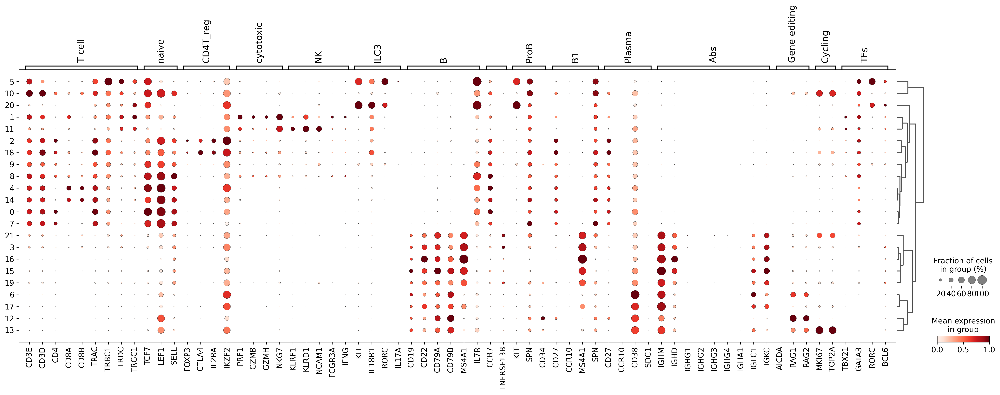

In [54]:
markers={
     'T cell': ['CD3E', 'CD3D','CD4', 'CD8A', 'CD8B','TRAC','TRBC1','TRDC','TRGC1'],
    'naive': ['TCF7', 'LEF1', 'SELL'],
    'CD4T_reg': ['FOXP3', 'CTLA4', 'IL2RA', 'IKZF2'],
    'cytotoxic': ['PRF1', 'GZMB', 'GZMH', 'NKG7'],
    'NK': ['KLRF1', 'KLRD1', 'NCAM1','FCGR3A','IFNG'],
    'ILC3': ['KIT', 'IL18R1','RORC','IL17A'],
    
    'B': ['CD19','CD20','CD22','CD79A', 'CD79B','MS4A1','IL7R',],
    '':['CCR7','TNFRSF13B',],
    'ProB':['KIT','SPN','CD34'],
    'B1':['CD27','CCR10','MS4A1','SPN'],
    'Plasma': ['CD27','CCR10','CD38','SDC1','JCAIN'],
    'Abs':['IGHM','IGHD', 'IGHG1','IGHG2', 'IGHG3','IGHG4', 'IGHA1','IGHE','IGLC1','IGKC'],
    'Gene editing': ['AICDA', 'RAG1','RAG2'],
    
    
    'Cycling':['MKI67','TOP2A'],

    'TFs': ['TBX21', 'GATA3', 'RORC', 'BCL6',],
}


for key in markers.keys():
    markers[key]=[x for x in markers[key] if x in adata.var_names]

sc.pl.dotplot(adata,
              markers, 
              groupby='leiden_scVI',
              dendrogram=True,
              standard_scale="var",
              color_map="Reds",
              # swap_axes=True,
             )

In [ ]:
adata.X.data[:10]

# DEG analysis

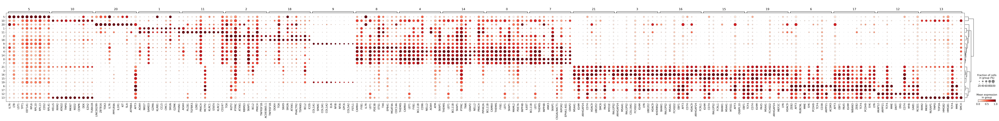

In [23]:
sc.tl.rank_genes_groups(adata, 'leiden_scVI', method='t-test')

DEG_dict = {}
for cluster in adata.obs['leiden_scVI'].cat.categories:
    df=rank_genes_groups_to_df(adata, cluster)
    # select genes: significant and up-regulated ones
    df=df[(df['pvals_adj']<0.05)&(df['logfoldchanges']>0)]
    # sort based on the logFC
    df.sort_values('scores',ascending=False,inplace=True)
    DEG_dict[cluster]=list(df[:10]['names'])
    del df

sc.pl.dotplot(adata,
              DEG_dict, 
              groupby='leiden_scVI',
              dendrogram=True,
              standard_scale="var",
              color_map="Reds",
              swap_axes=False,
             )

# CellTypist prediction

In [24]:
# load model and predict
panfetal_model = models.Model.load('/nfs/team205/kk18/Analysis/celltypist/models/celltypist_model.Pan_Fetal_Human.pkl')
prediction=celltypist.annotate(adata, model = panfetal_model, majority_voting = True)

🔬 Input data has 21336 cells and 28811 genes
🔗 Matching reference genes in the model
🧬 6669 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Detected a neighborhood graph in the input object, will run over-clustering on the basis of it
⛓️ Over-clustering input data with resolution set to 15
🗳️ Majority voting the predictions
✅ Majority voting done!


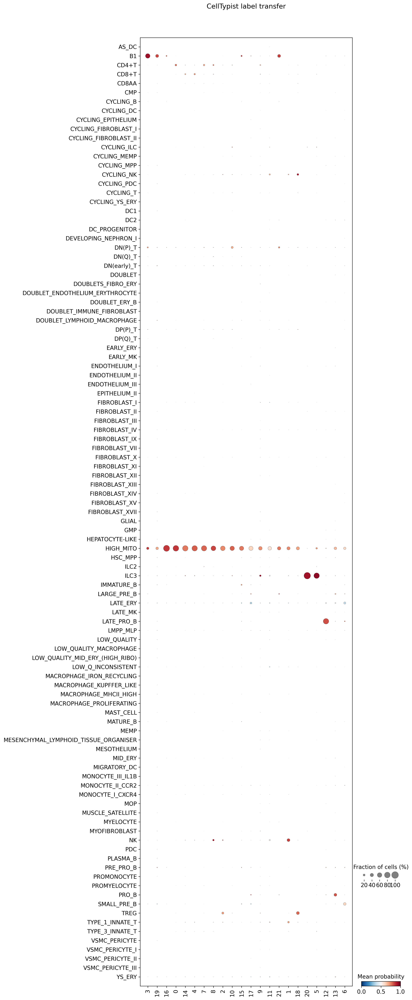

In [25]:
celltypist.dotplot(prediction, use_as_reference = 'leiden_scVI', use_as_prediction = 'predicted_labels')

# Annotation 

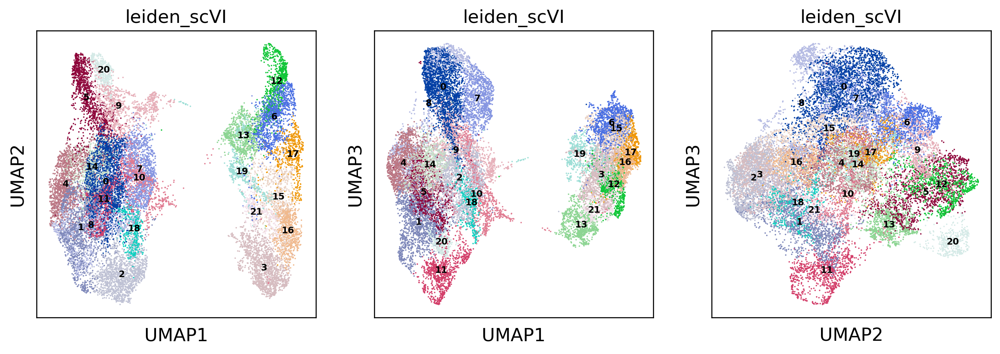

In [26]:
sc.pl.umap(adata, color=['leiden_scVI'], size=5, wspace=0.1, legend_loc='on data', components='all', legend_fontsize=7)

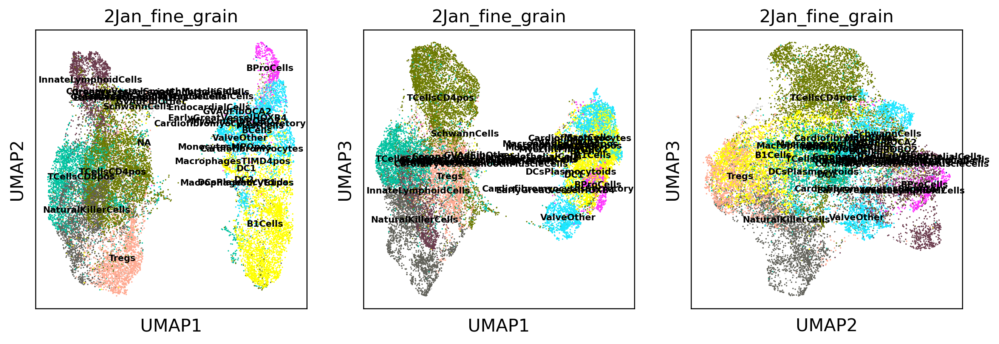

In [28]:
sc.pl.umap(adata, color=['2Jan_fine_grain'], size=5, wspace=0.1, legend_loc='on data', components='all', legend_fontsize=7)

In [27]:
set(adata.obs['2Jan_fine_grain'])

{'B1Cells',
 'BCells',
 'BProCells',
 'Cardiofibromyocytes',
 'CardiofibromyocytesSecretory',
 'CoronaryCapillaryEndothelialCells',
 'CoronaryVesselSmoothMuscleCells',
 'DC1',
 'DC2',
 'DCsPlasmocytoids',
 'EarlyGreatVesselFLRT2',
 'EarlyGreatVesselHOXB4',
 'EndocardialCells',
 'GVAdFibOCA2',
 'GVAdFibOther',
 'GreatVesselArterialEndothelialCells',
 'GreatVesselSmoothMuscleCells',
 'InnateLymphoidCells',
 'MacrophagesLYVE1pos',
 'MacrophagesTIMD4pos',
 'MastCells',
 'MonocytesMPOpos',
 'MyocIntFibROBO2',
 'NaturalKillerCells',
 'SchwannCells',
 'TCellsCD4pos',
 'TCellsCD8pos',
 'Tregs',
 'ValveOther',
 nan}

In [64]:
adata.obs['cell_type3']=adata.obs['leiden_scVI'].astype('str').copy()
adata.obs.replace({'cell_type3':{
    '0':'CD4+T', 
    '1':'NK', 
    '2':'CD4+Treg', 
    '3':'B_MS4A1+', # MS4A1, IgD, CellTypist
    '4':'CD8+T', 
    '5':'ILC',  
    '6':'B', 
    '7':'CD4+T',  
    '8':'CD4+T', 
    '9':'CD4+T', 
    '10':'T_cycling',  
    '11':'NK',
    '12':'Bpro', # CD34, RAG genes, CellTypist
    '13':'B_cycling', 
    '14':'CD8+T', 
    '15':'B_MS4A1+',# MS4A1, IgD, CellTypist
    '16':'B_MS4A1+',# MS4A1, IgD, CellTypist
    '17':'B', 
    '18':'CD4+Treg', 
    '19':'B_MS4A1+',# MS4A1, IgD, CellTypist
    '20':'ILC',
    '21':'B_MS4A1+',# MS4A1, IgD, CellTypist
}}, inplace=True)


adata.obs['cell_type3']=adata.obs['cell_type3'].astype('category')
adata.obs['cell_type3'].cat.reorder_categories([
    'CD4+T',
    'CD4+Treg',
    'CD8+T',
    'NK', 
    'ILC',
    'T_cycling', 
    'Bpro',
    'B', 
    'B_MS4A1+',
    'B_cycling',
    # 'Doublet'
], inplace=True)

adata.obs['cell_type3'].value_counts()

CD4+T        5206
B_MS4A1+     3722
NK           2437
CD8+T        2121
CD4+Treg     1940
B            1666
ILC          1639
T_cycling     912
Bpro          850
B_cycling     843
Name: cell_type3, dtype: int64

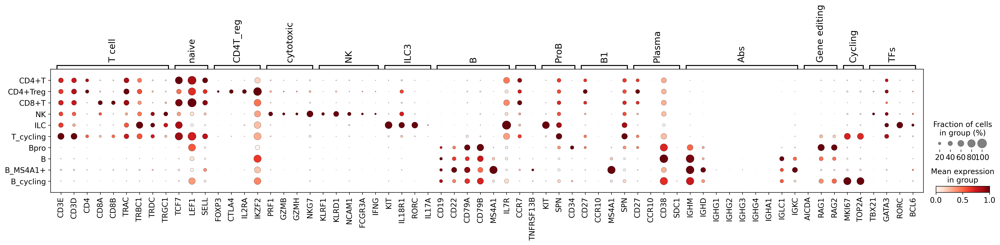

In [65]:
markers={
     'T cell': ['CD3E', 'CD3D','CD4', 'CD8A', 'CD8B','TRAC','TRBC1','TRDC','TRGC1'],
    'naive': ['TCF7', 'LEF1', 'SELL'],
    'CD4T_reg': ['FOXP3', 'CTLA4', 'IL2RA', 'IKZF2'],
    'cytotoxic': ['PRF1', 'GZMB', 'GZMH', 'NKG7'],
    'NK': ['KLRF1', 'KLRD1', 'NCAM1','FCGR3A','IFNG'],
    'ILC3': ['KIT', 'IL18R1','RORC','IL17A'],
    
    'B': ['CD19','CD20','CD22','CD79A', 'CD79B','MS4A1','IL7R',],
    '':['CCR7','TNFRSF13B',],
    'ProB':['KIT','SPN','CD34'],
    'B1':['CD27','CCR10','MS4A1','SPN'],
    'Plasma': ['CD27','CCR10','CD38','SDC1','JCAIN'],
    'Abs':['IGHM','IGHD', 'IGHG1','IGHG2', 'IGHG3','IGHG4', 'IGHA1','IGHE','IGLC1','IGKC'],
    'Gene editing': ['AICDA', 'RAG1','RAG2'],
    
    
    'Cycling':['MKI67','TOP2A'],

    'TFs': ['TBX21', 'GATA3', 'RORC', 'BCL6',],
}


for key in markers.keys():
    markers[key]=[x for x in markers[key] if x in adata.var_names]

sc.pl.dotplot(adata,
              markers, 
              groupby='cell_type3',
              dendrogram=False,
              standard_scale="var",
              color_map="Reds",
              # swap_axes=True,
             )

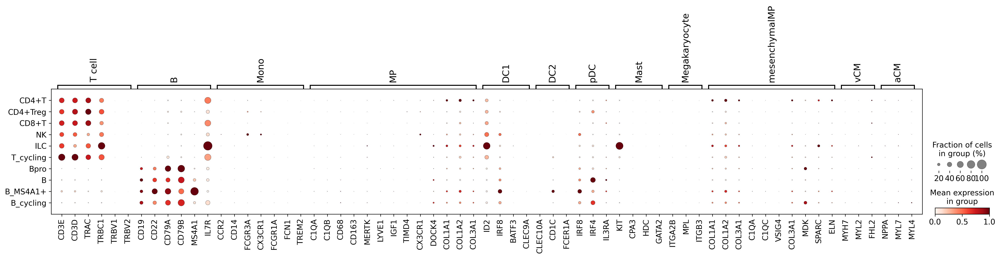

In [74]:
markers={
     'T cell': ['CD3E', 'CD3D','TRAC','TRBC1','TRBV1','TRBV2'],
     'B': ['CD19','CD20','CD22','CD79A', 'CD79B','MS4A1','IL7R',],
   
    
    'Mono':['CCR2','CD14','FCGR3A','CX3CR1','FCGR1A','FCN1','TREM2'],
    'MP':['C1QA','C1QB','CD68','CD163','MERTK','LYVE1','IGF1','TIMD4','CX3CR1','DOCK4','COL1A1','COL1A2','COL3A1'],
    'DC1':['ID2','IRF8','BATF3','CLEC9A'],
    'DC2':['CLEC10A','CD1C','FCER1A',],
    'pDC':['IRF8','IRF4','IL3RA'],
    
   
    'Mast': ['KIT', 'CPA3','HDC','GATA2'],
    'Megakaryocyte':['ITGA2B','MPL','ITGB3',],
    'mesenchymalMP':['COL1A1','COL1A2','COL3A1','C1QA','C1QC','C1QD','VSIG4','COL3A1', 'MDK', 'SPARC', 'ELN'],
    'vCM': ['MYH7', 'MYL2', 'FHL2'],
    'aCM': ['NPPA', 'MYL7', 'MYL4'],
}


for key in markers.keys():
    markers[key]=[x for x in markers[key] if x in adata.var_names]

sc.pl.dotplot(adata,
              markers, 
              groupby='cell_type3',
              dendrogram=False,
              standard_scale="var",
              color_map="Reds",
              # swap_axes=True,
             )

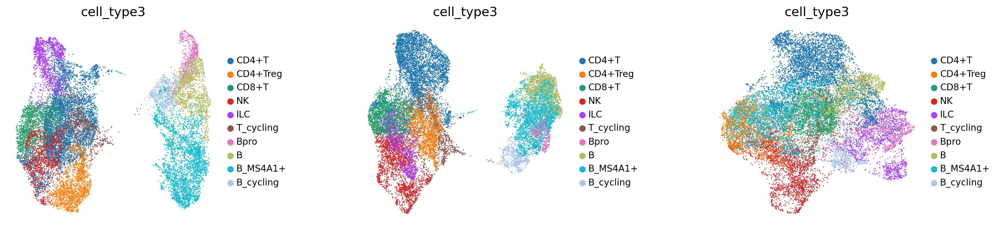

In [80]:
sc.settings.set_figure_params(dpi=120,  color_map = 'RdPu',)
sc.pl.umap(adata, color=['cell_type3'], size=5, legend_fontsize=10, frameon=False, components='all', wspace=0.5)

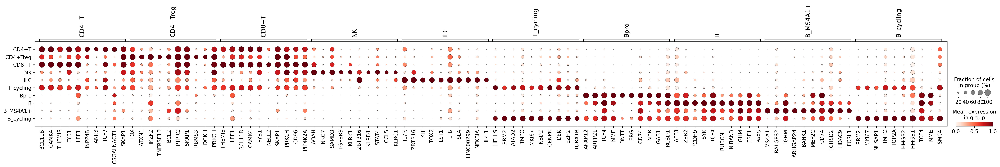

In [67]:
sc.tl.rank_genes_groups(adata, 'cell_type3', method='t-test')

DEG_dict = {}
for cluster in adata.obs['cell_type3'].cat.categories:
    df=rank_genes_groups_to_df(adata, cluster)
    # select genes: significant and up-regulated ones
    df=df[(df['pvals_adj']<0.05)&(df['logfoldchanges']>0)]
    # sort based on the logFC
    df.sort_values('scores',ascending=False,inplace=True)
    DEG_dict[cluster]=list(df[:10]['names'])
    del df

sc.pl.dotplot(adata,
              DEG_dict, 
              groupby='cell_type3',
              dendrogram=False,
              standard_scale="var",
              color_map="Reds",
              swap_axes=False,
             )

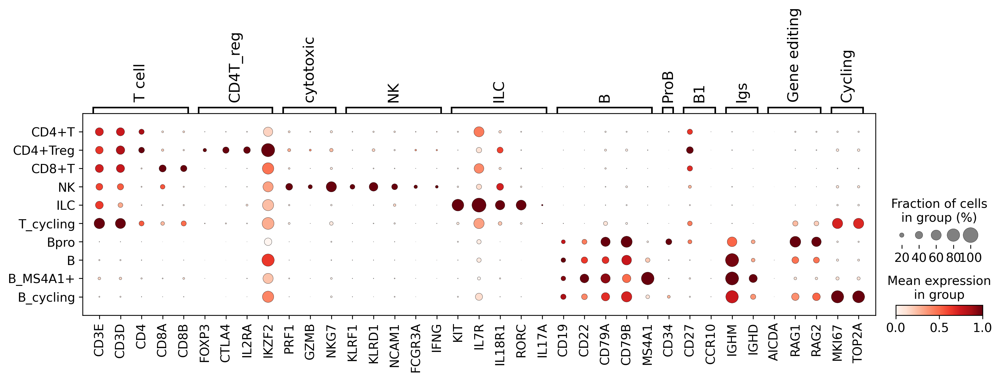

In [88]:
markers={
     'T cell': ['CD3E', 'CD3D','CD4', 'CD8A', 'CD8B'],
    'CD4T_reg': ['FOXP3', 'CTLA4', 'IL2RA', 'IKZF2'],
    'cytotoxic': ['PRF1', 'GZMB','NKG7'],
    'NK': ['KLRF1', 'KLRD1','NCAM1','FCGR3A','IFNG'],
    'ILC': ['KIT', 'IL7R','IL18R1','RORC','IL17A'],   
    'B': ['CD19','CD20','CD22','CD79A', 'CD79B','MS4A1'],
     'ProB':['CD34'],
    'B1':['CD27','CCR10'],
    'Igs':['IGHM','IGHD'],
    'Gene editing': ['AICDA', 'RAG1','RAG2'],
    'Cycling':['MKI67','TOP2A'],
}


for key in markers.keys():
    markers[key]=[x for x in markers[key] if x in adata.var_names]

sc.pl.dotplot(adata[adata.obs['cell_type3']!='Doublet'],
              markers, 
              groupby='cell_type3',
              dendrogram=False,
              standard_scale="var",
              color_map="Reds",
              # swap_axes=True,
             )

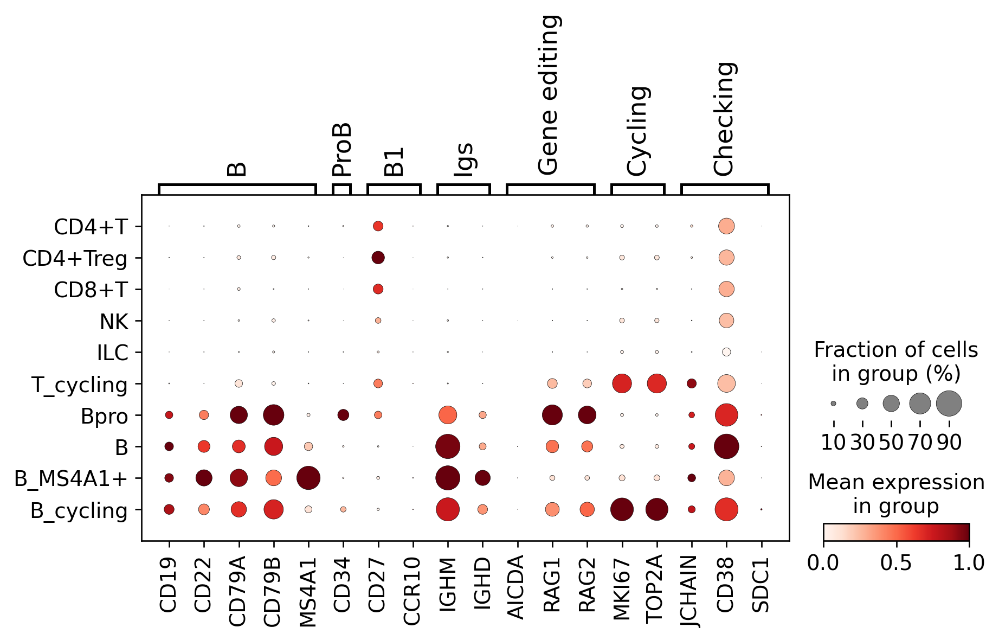

In [87]:
markers={
    'B': ['CD19','CD20','CD22','CD79A', 'CD79B','MS4A1'],
     'ProB':['CD34'],
    'B1':['CD27','CCR10'],
    'Igs':['IGHM','IGHD'],
    'Gene editing': ['AICDA', 'RAG1','RAG2'],
    'Cycling':['MKI67','TOP2A'],
    'Checking':['JCHAIN','CD38','SDC1'],
}


for key in markers.keys():
    markers[key]=[x for x in markers[key] if x in adata.var_names]

sc.pl.dotplot(adata[adata.obs['cell_type3']!='Doublet'],
              markers, 
              groupby='cell_type3',
              dendrogram=False,
              standard_scale="var",
              color_map="Reds",
              # swap_axes=True,
             )

In [105]:
adata.obs['cell_type3'].astype('str') + ' | ' + adata.obs['cell_or_nuclei'].astype('str')

barcode
BHF_F_Hea10402917_ATGTGTGTCGAACGGA-1                                ILC | cell
BHF_F_Hea10402917_CAGGTGCAGGCTATCT-1                                  B | cell
BHF_F_Hea10402917_ATAACGCTCCACGACG-1                              CD4+T | cell
BHF_F_Hea10402917_CACAGTAGTATAGGGC-1                          B_cycling | cell
BHF_F_Hea10402917_GCTGGGTGTGCGGTAA-1                           B_MS4A1+ | cell
                                                                   ...        
HCAHeartST13386010_HCAHeartST13303420_AATTTGCCATAAGCAA-1           NK | nuclei
HCAHeartST13386010_HCAHeartST13303420_GGATTGCGTGGTTCTT-1    B_cycling | nuclei
HCAHeartST13386010_HCAHeartST13303420_TGTGCGGGTGTCACGG-1     CD4+Treg | nuclei
HCAHeartST13386010_HCAHeartST13303420_CTATTCAGTAGGATTT-1          ILC | nuclei
HCAHeartST13386010_HCAHeartST13303420_CTCACACTCGACCTGA-1     CD4+Treg | nuclei
Length: 21336, dtype: object

... storing 'cell_type3_cllnuclei' as categorical


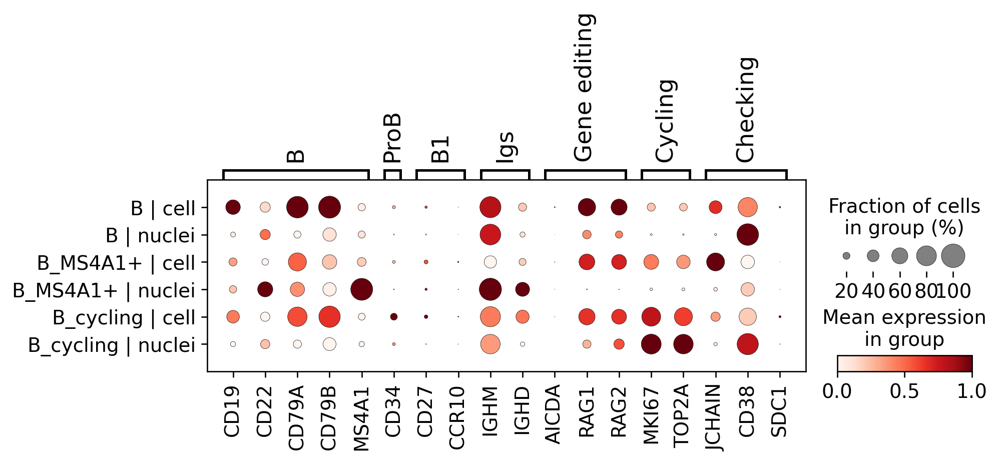

In [108]:
# celltype x cell_nuclei
adata.obs['cell_type3_cllnuclei'] = adata.obs['cell_type3'].astype('str') + ' | ' + adata.obs['cell_or_nuclei'].astype('str')

markers={
    'B': ['CD19','CD20','CD22','CD79A', 'CD79B','MS4A1'],
     'ProB':['CD34'],
    'B1':['CD27','CCR10'],
    'Igs':['IGHM','IGHD'],
    'Gene editing': ['AICDA', 'RAG1','RAG2'],
    'Cycling':['MKI67','TOP2A'],
    'Checking':['JCHAIN','CD38','SDC1'],
}


for key in markers.keys():
    markers[key]=[x for x in markers[key] if x in adata.var_names]

sc.pl.dotplot(adata[(adata.obs['cell_type3']!='Doublet')&(adata.obs['cell_or_nuclei']!='na')&(adata.obs['cell_type3'].isin(['B','B_MS4A1+','B_cycling']))],
              markers, 
              groupby='cell_type3_cllnuclei',
              dendrogram=False,
              standard_scale="var",
              color_map="Reds",
              # swap_axes=True,
             )

... storing 'cell_type3_cllnuclei' as categorical


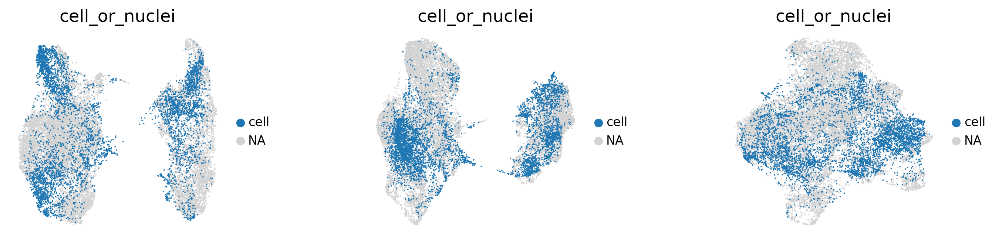

In [109]:
sc.pl.umap(adata, color=['cell_or_nuclei'], groups='cell', size=5, legend_fontsize=10, frameon=False, components='all', wspace=0.5)

In [ ]:
sc.pl.umap(adata, color=['cell_or_nuclei'], groups='nuclei', size=5, legend_fontsize=10, frameon=False, components='all', wspace=0.5)

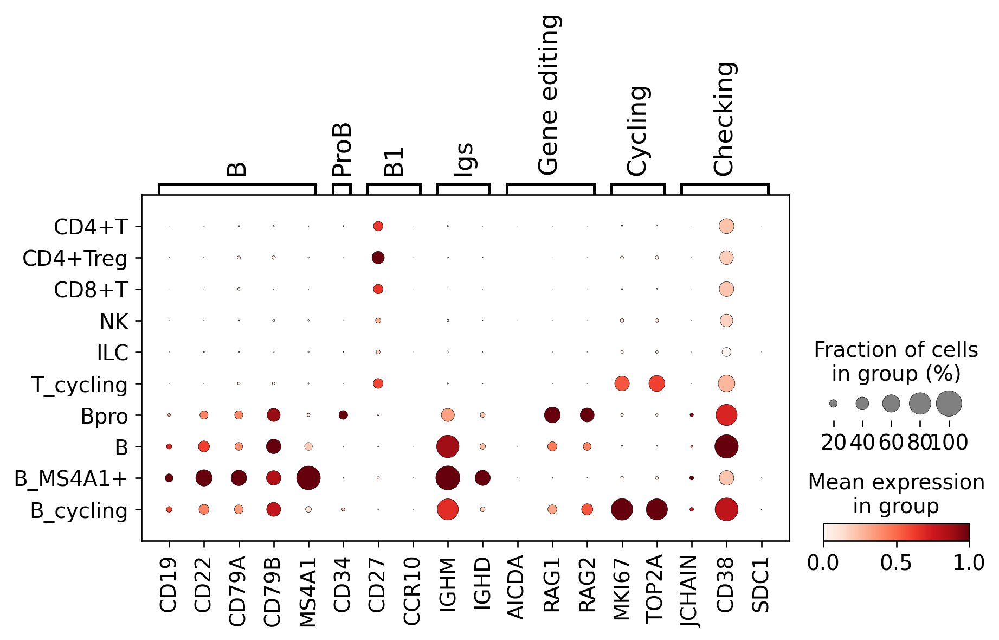

In [102]:
# celltype x cell_nuclei
markers={
    'B': ['CD19','CD20','CD22','CD79A', 'CD79B','MS4A1'],
     'ProB':['CD34'],
    'B1':['CD27','CCR10'],
    'Igs':['IGHM','IGHD'],
    'Gene editing': ['AICDA', 'RAG1','RAG2'],
    'Cycling':['MKI67','TOP2A'],
    'Checking':['JCHAIN','CD38','SDC1'],
}


for key in markers.keys():
    markers[key]=[x for x in markers[key] if x in adata.var_names]

sc.pl.dotplot(adata[(adata.obs['cell_type3']!='Doublet')&(adata.obs['cell_or_nuclei']=='nuclei')],
              markers, 
              groupby='cell_type3',
              dendrogram=False,
              standard_scale="var",
              color_map="Reds",
              # swap_axes=True,
             )

# Recover row counts and save

In [69]:
adata_raw=sc.read_h5ad('/nfs/team205/heart/anndata_objects/Foetal/Immune/RNA_foetal_raw_immune_16Feb2023.h5ad')
print(adata_raw.shape)

adata_raw=anndata.AnnData(X=adata_raw[adata.obs_names,:].X,
                      obs=adata.obs, # from annotated or subsetted data
                      var=adata_raw.var,
                      obsm=adata.obsm, # from annotated or subsetted data
                      obsp=adata.obsp # from annotated or subsetted data
                               )
print(adata_raw.shape)

(41881, 36601)
(21336, 36601)


In [70]:
adata_raw.write('/nfs/team205/heart/anndata_objects/Foetal/Immune/RNA_foetal_raw_Lymphoid_16Feb2023.h5ad')
adata_raw

AnnData object with n_obs × n_vars = 21336 × 36601
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'sangerID', 'combinedID', 'donor', 'donor_type', 'region', 'region_finest', 'age', 'gender', 'facility', 'cell_or_nuclei', 'modality', 'kit_10x', 'flushed', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'n_genes', 'n_counts', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'HB_score', 'donor_by_library-prep', 'multiplexed', 'SOC | status', 'SOC | log_prob_singleton', 'SOC | log_prob_doublet', 'batch_key', '_scvi_batch', '_scvi_labels', '2Jan_coarse_grain', '2Jan_mid_grain', '2Jan_fine_grain', 'leiden_scVI', 'FACSgate', 'sex', 'week', 'trimester', 'cell_type2', 'cell_type3'
    var: 'gene_name_scRNA-0', 'gene_id'
    obsm: 'X_pca', 'X_scVI', 'X_uma

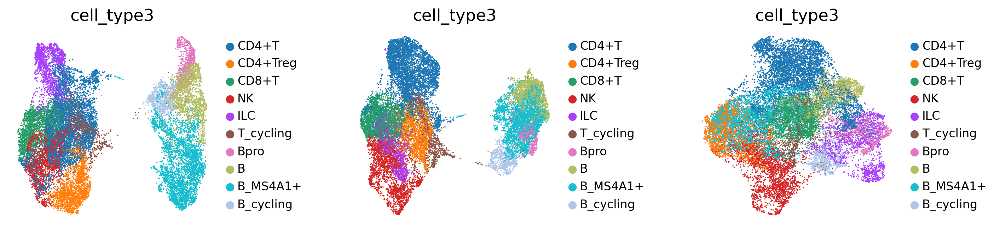

In [71]:
sc.pl.umap(adata_raw, color=['cell_type3'], size=5, legend_fontsize=10, frameon=False, components='all', wspace=0.5)

In [79]:
# save metadata
adata_raw.obs.to_csv('/nfs/team205/heart/anndata_objects/Foetal/Immune/RNA_foetal_raw_Lymphoid_16Feb2023.obs.csv')

In [ ]:
# read in saved object
adata_raw = sc.read_h5ad('/nfs/team205/heart/anndata_objects/Foetal/Immune/RNA_foetal_raw_Lymphoid_16Feb2023.h5ad')
adata_raw

In [6]:
# log-normalise
adata = adata_raw.copy()
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)

In [28]:
adata.X.data[:10]

array([0.20843568, 0.38083044, 0.20843568, 0.20843568, 0.20843568,
       0.38083044, 0.38083044, 0.76952875, 0.38083044, 0.38083044],
      dtype=float32)

# Assign non-cycling cell type labels to "T_cycling" cells

## 1) Regressing out cell cycle genes

In [7]:
# cell cycle genes
cell_cycle_genes = [x.strip() for x in open('/nfs/team205/kk18/data/geneset/scanpy_cell_cycle_vignette_files/regev_lab_cell_cycle_genes.txt')]

s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]

# select genes which are in the adata
cell_cycle_genes = [x for x in cell_cycle_genes if x in adata.var_names]
s_genes = [x for x in s_genes if x in adata.var_names]
g2m_genes = [x for x in g2m_genes if x in adata.var_names]

... storing 'phase' as categorical


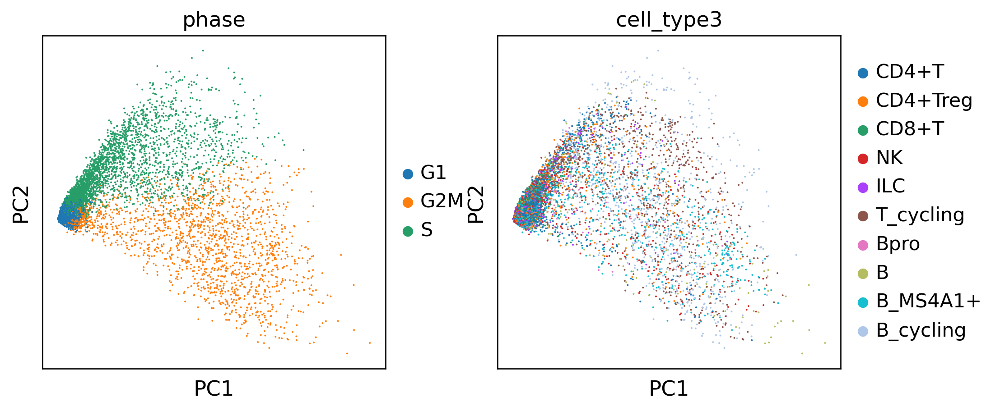

CPU times: user 13.8 s, sys: 10.1 s, total: 23.9 s
Wall time: 20.1 s


In [21]:
%%time
adata_reg = adata.copy()

# scaling and scoring
sc.pp.scale(adata_reg)
sc.tl.score_genes_cell_cycle(adata_reg, s_genes=s_genes, g2m_genes=g2m_genes)

# Running a PCA on cell cycle genes reveals, unsurprisingly, cells separate by phase
adata_cc_genes = adata_reg[:, cell_cycle_genes]
sc.tl.pca(adata_cc_genes)
sc.pl.pca_scatter(adata_cc_genes, color=['phase','cell_type3'])

... storing 'phase' as categorical


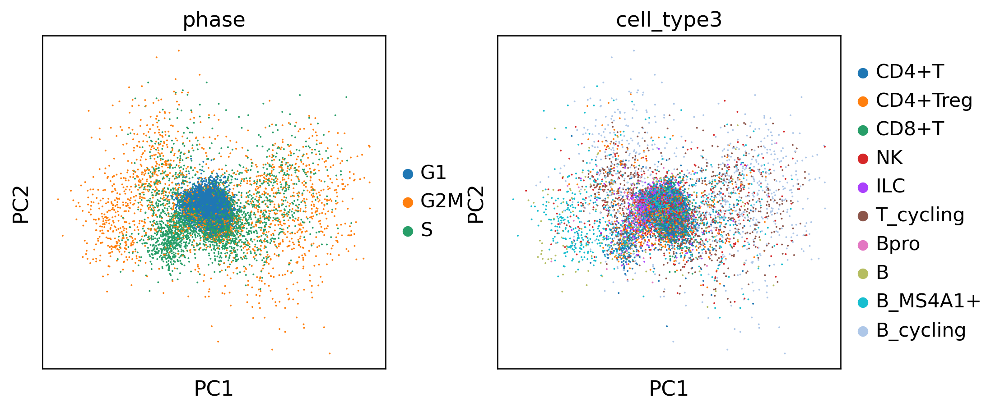

CPU times: user 7h 15min 49s, sys: 12h 43min 29s, total: 19h 59min 19s
Wall time: 2h 6min 26s


In [22]:
%%time

# regress out
sc.pp.regress_out(adata_reg, ['S_score', 'G2M_score'])
sc.pp.scale(adata_reg)

# When running a PCA on only cell cycle genes, cells no longer separate by cell-cycle phase
adata_cc_genes = adata_reg[:, cell_cycle_genes]
sc.tl.pca(adata_cc_genes)
sc.pl.pca_scatter(adata_cc_genes, color=['phase','cell_type3'])

In [23]:
# save regressed out object
adata_reg.write('/nfs/team205/heart/anndata_objects/Foetal/Immune/RNA_foetal_raw_Lymphoid_16Feb2023_CCregressed-scaled.h5ad')
adata_reg

AnnData object with n_obs × n_vars = 21336 × 36601
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'sangerID', 'combinedID', 'donor', 'donor_type', 'region', 'region_finest', 'age', 'gender', 'facility', 'cell_or_nuclei', 'modality', 'kit_10x', 'flushed', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'n_genes', 'n_counts', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'HB_score', 'donor_by_library-prep', 'multiplexed', 'SOC | status', 'SOC | log_prob_singleton', 'SOC | log_prob_doublet', 'batch_key', '_scvi_batch', '_scvi_labels', '2Jan_coarse_grain', '2Jan_mid_grain', '2Jan_fine_grain', 'leiden_scVI', 'FACSgate', 'sex', 'week', 'trimester', 'cell_type2', 'cell_type3', 'S_score', 'G2M_score', 'phase'
    var: 'gene_name_scRNA-0', 'gene_id', '

In [9]:
adata_reg = sc.read_h5ad('/nfs/team205/heart/anndata_objects/Foetal/Immune/RNA_foetal_raw_Lymphoid_16Feb2023_CCregressed-scaled.h5ad')
adata_reg

AnnData object with n_obs × n_vars = 21336 × 36601
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'sangerID', 'combinedID', 'donor', 'donor_type', 'region', 'region_finest', 'age', 'gender', 'facility', 'cell_or_nuclei', 'modality', 'kit_10x', 'flushed', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'n_genes', 'n_counts', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'HB_score', 'donor_by_library-prep', 'multiplexed', 'SOC | status', 'SOC | log_prob_singleton', 'SOC | log_prob_doublet', 'batch_key', '_scvi_batch', '_scvi_labels', '2Jan_coarse_grain', '2Jan_mid_grain', '2Jan_fine_grain', 'leiden_scVI', 'FACSgate', 'sex', 'week', 'trimester', 'cell_type2', 'cell_type3', 'S_score', 'G2M_score', 'phase'
    var: 'gene_name_scRNA-0', 'gene_id', '

## 2) Train LR model with non-cycling cells (only for non-B cells)

In [10]:
adata_nc = adata_reg[adata_reg.obs['cell_type3'].isin(['CD4+T',
                                                        'CD4+Treg',
                                                        'CD8+T',
                                                        'NK', 
                                                        'ILC',
                                                        ])]
adata_nc.obs['cell_type3'].value_counts()

CD4+T       5206
NK          2437
CD8+T       2121
CD4+Treg    1940
ILC         1639
Name: cell_type3, dtype: int64

In [11]:
# downsize for training
adata_nc = sctk.subsample(adata_nc, 
                     fraction=1, 
                     groupby='cell_type3', 
                     min_n=0, max_n=1000, method='random', index_only=False, random_state=0)
adata_nc.obs['cell_type3'].value_counts()

CD4+T       1000
CD4+Treg    1000
CD8+T       1000
NK          1000
ILC         1000
Name: cell_type3, dtype: int64

In [12]:
%%time
# train
lr = sctk.LR_train(adata_nc, groupby='cell_type3', use_rep='X',)

CPU times: user 2h 23min 55s, sys: 11.5 s, total: 2h 24min 7s
Wall time: 2h 27min 15s


In [13]:
lr

LogisticRegression(C=0.1, n_jobs=-1, solver='saga', warm_start=True)

In [15]:
import joblib

outdir = os.path.dirname('/home/jovyan/projects/P37_Foetal-heart_scnRNA/notebooks/v20230207_withShinhalab/LR/foetal_heart_T-NK-ILC_wo-cycling')
if outdir:
    os.makedirs(outdir, exist_ok=True)
joblib.dump(lr, '/home/jovyan/projects/P37_Foetal-heart_scnRNA/notebooks/v20230207_withShinhalab/LR/foetal_heart_T-NK-ILC_wo-cycling')

['/home/jovyan/projects/P37_Foetal-heart_scnRNA/notebooks/v20230207_withShinhalab/LR/foetal_heart_T-NK-ILC_wo-cycling']

## 3) Predict cell states

In [16]:
adata_cyc = adata_reg[adata_reg.obs['cell_type3']=='T_cycling']
adata_cyc

View of AnnData object with n_obs × n_vars = 912 × 36601
    obs: 'latent_RT_efficiency', 'latent_cell_probability', 'latent_scale', 'sangerID', 'combinedID', 'donor', 'donor_type', 'region', 'region_finest', 'age', 'gender', 'facility', 'cell_or_nuclei', 'modality', 'kit_10x', 'flushed', 'scrublet_score', 'scrublet_leiden', 'cluster_scrublet_score', 'doublet_pval', 'doublet_bh_pval', 'n_genes', 'n_counts', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'HB_score', 'donor_by_library-prep', 'multiplexed', 'SOC | status', 'SOC | log_prob_singleton', 'SOC | log_prob_doublet', 'batch_key', '_scvi_batch', '_scvi_labels', '2Jan_coarse_grain', '2Jan_mid_grain', '2Jan_fine_grain', 'leiden_scVI', 'FACSgate', 'sex', 'week', 'trimester', 'cell_type2', 'cell_type3', 'S_score', 'G2M_score', 'phase'
    var: 'gene_name_scRNA-0', 'gene_

In [18]:
result = sctk.LR_predict(adata_cyc, lr, use_rep='X',return_predict=True)

36601 features used for prediction


In [21]:
print(result['label'][:5])
result['prob'].head()

['ILC' 'ILC' 'ILC' 'NK' 'NK']


,CD4+T,CD4+Treg,CD8+T,ILC,NK
barcode,,,,,
BHF_F_Hea10402917_GAACCTAGTCTCCATC-1,0.000521,0.000004,0.000011,0.998461,0.001002
BHF_F_Hea10402917_GCTTCCAAGCCGCCTA-1,0.000064,0.000044,0.000388,0.998812,0.000692
BHF_F_Hea10402917_TTTGCGCGTGCATCTA-1,0.000275,0.000118,0.000244,0.999307,0.000057
BHF_F_Hea10402917_GGGACCTGTACCGCTG-1,0.000449,0.007506,0.018576,0.000868,0.972602
BHF_F_Hea10402917_GCTCTGTCATGTAAGA-1,0.011286,0.007718,0.048399,0.092282,0.840315


In [30]:
adata.obs['LR']=np.nan
adata.obs.loc[result['prob'].index,'LR']=result['label']
adata.obs['LR'].value_counts()

CD4+T       454
CD8+T       176
CD4+Treg    156
ILC          80
NK           46
Name: LR, dtype: int64

... storing 'LR' as categorical


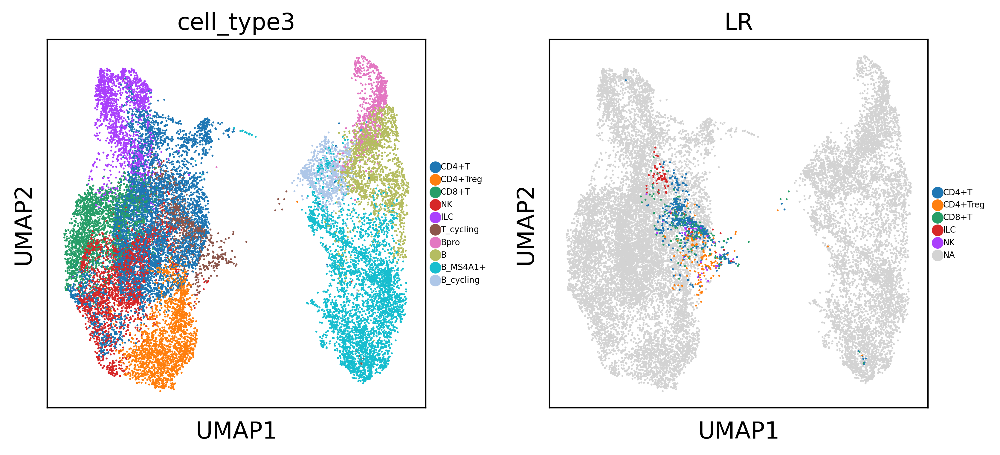

In [31]:
sc.settings.set_figure_params(dpi=200, facecolor='white', color_map = 'RdPu',)
sc.pl.umap(adata, color=['cell_type3','LR'], legend_fontsize=5)

## 4) Check marker expressions

In [48]:
Tcycling_ids = adata.obs_names[adata.obs['LR'].isna()==False]

adata.obs['cell_type4'] = adata.obs['cell_type3'].copy()
adata.obs['cell_type5'] = adata.obs['cell_type3'].copy()
adata.obs['cell_type4'] = adata.obs['cell_type4'].astype('str')
adata.obs['cell_type5'] = adata.obs['cell_type5'].astype('str')
adata.obs.loc[Tcycling_ids,'cell_type4'] = adata.obs.loc[Tcycling_ids,'LR'].astype('str')+'_cycling'
adata.obs.loc[Tcycling_ids,'cell_type5'] = adata.obs.loc[Tcycling_ids,'LR']
adata.obs['cell_type4'].value_counts()

CD4+T               5206
B_MS4A1+            3722
NK                  2437
CD8+T               2121
CD4+Treg            1940
B                   1666
ILC                 1639
Bpro                 850
B_cycling            843
CD4+T_cycling        454
CD8+T_cycling        176
CD4+Treg_cycling     156
ILC_cycling           80
NK_cycling            46
Name: cell_type4, dtype: int64

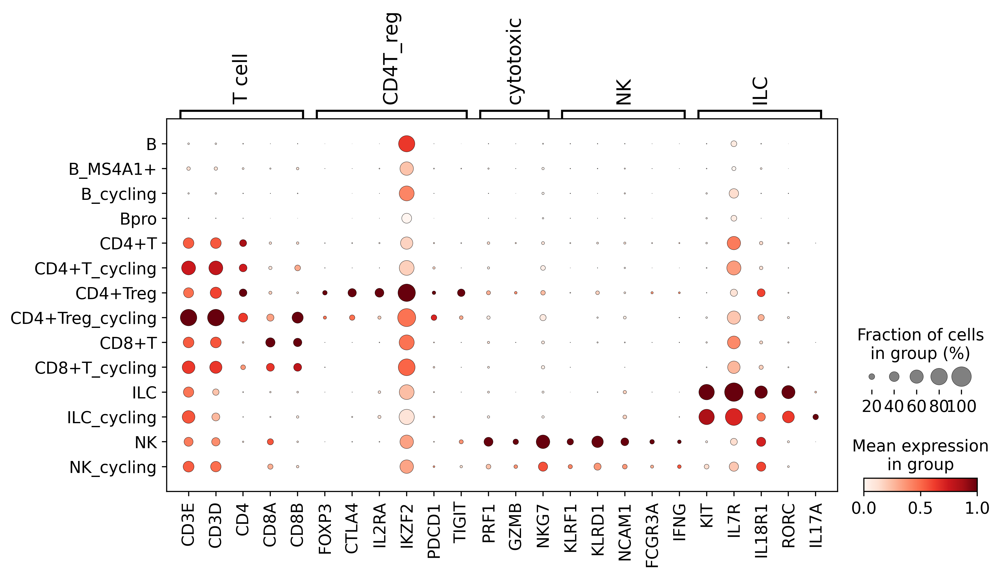

In [47]:
markers={
     'T cell': ['CD3E', 'CD3D','CD4', 'CD8A', 'CD8B'],
    'CD4T_reg': ['FOXP3', 'CTLA4', 'IL2RA', 'IKZF2','PDCD1','TIGIT'],
    'cytotoxic': ['PRF1', 'GZMB','NKG7'],
    'NK': ['KLRF1', 'KLRD1','NCAM1','FCGR3A','IFNG'],
    'ILC': ['KIT', 'IL7R','IL18R1','RORC','IL17A']
}


for key in markers.keys():
    markers[key]=[x for x in markers[key] if x in adata.var_names]

sc.pl.dotplot(adata,
              markers, 
              groupby='cell_type4',
              dendrogram=False,
              standard_scale="var",
              color_map="Reds",
              # swap_axes=True,
             )

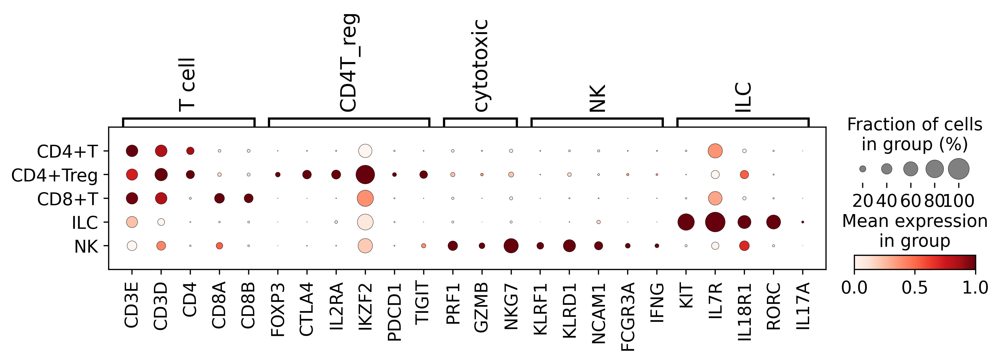

In [50]:
markers={
     'T cell': ['CD3E', 'CD3D','CD4', 'CD8A', 'CD8B'],
    'CD4T_reg': ['FOXP3', 'CTLA4', 'IL2RA', 'IKZF2','PDCD1','TIGIT'],
    'cytotoxic': ['PRF1', 'GZMB','NKG7'],
    'NK': ['KLRF1', 'KLRD1','NCAM1','FCGR3A','IFNG'],
    'ILC': ['KIT', 'IL7R','IL18R1','RORC','IL17A']
}


for key in markers.keys():
    markers[key]=[x for x in markers[key] if x in adata.var_names]

sc.pl.dotplot(adata[adata.obs['cell_type5'].isin(['CD4+T','CD4+Treg','CD8+T','ILC','NK'])],
              markers, 
              groupby='cell_type5',
              dendrogram=False,
              standard_scale="var",
              color_map="Reds",
              # swap_axes=True,
             )

## 5) Save assigned list

In [61]:
adata_Tcycling = adata[Tcycling_ids]
adata_Tcycling.shape

(912, 36601)

In [62]:
adata_Tcycling.obs['cell_type5'].value_counts()

CD4+T       454
CD8+T       176
CD4+Treg    156
ILC          80
NK           46
Name: cell_type5, dtype: int64

In [63]:
FineGrainKey='cell_type5'
for k in list(set(adata_Tcycling.obs[FineGrainKey])):
    k_mod = k.replace('+','')
    np.savetxt('/nfs/team205/heart/anndata_objects/Foetal/Immune/Tcycling/'+k_mod+'.txt', adata_Tcycling[adata_Tcycling.obs[FineGrainKey]==k,:].obs_names, delimiter="\n", fmt="%s")
    print(k)

NK
CD4+T
CD4+Treg
CD8+T
ILC


In [ ]:
rclone copy /nfs/team205/heart/anndata_objects/Foetal/Immune/Tcycling \
gdrive:JamesC_Kazumasa/Foetal_Heart/SanjayShinha/toSinhalab/anndata/Immune_16Feb2023/Tcycling

# Celltypist, pan-foetal immune

In [41]:
# load model and predict
panfetal_model = models.Model.load('/nfs/team205/kk18/Analysis/celltypist/models/celltypist_model.Pan_Fetal_Human.pkl')
sc.pp.neighbors(adata, use_rep="X_scVI")
prediction=celltypist.annotate(adata, model = panfetal_model, majority_voting = True)

🔬 Input data has 21336 cells and 28811 genes
🔗 Matching reference genes in the model
🧬 6669 features used for prediction
⚖️ Scaling input data
🖋️ Predicting labels
✅ Prediction done!
👀 Detected a neighborhood graph in the input object, will run over-clustering on the basis of it
⛓️ Over-clustering input data with resolution set to 15
🗳️ Majority voting the predictions
✅ Majority voting done!


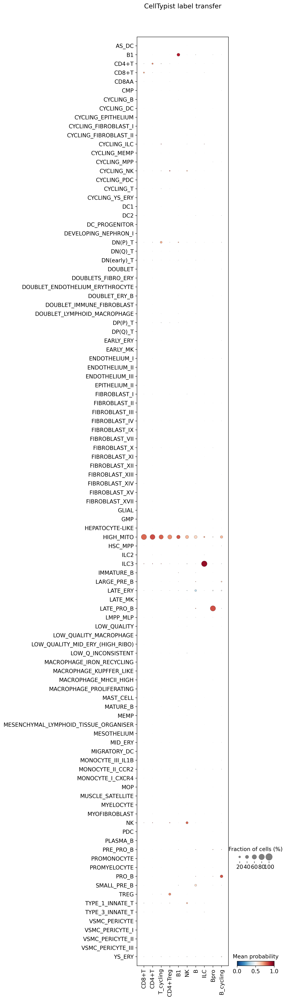

In [42]:
celltypist.dotplot(prediction, use_as_reference = 'cell_type3', use_as_prediction = 'predicted_labels')

# Check matching with previoius annotation

<AxesSubplot:xlabel='2Jan_fine_grain', ylabel='cell_type3'>

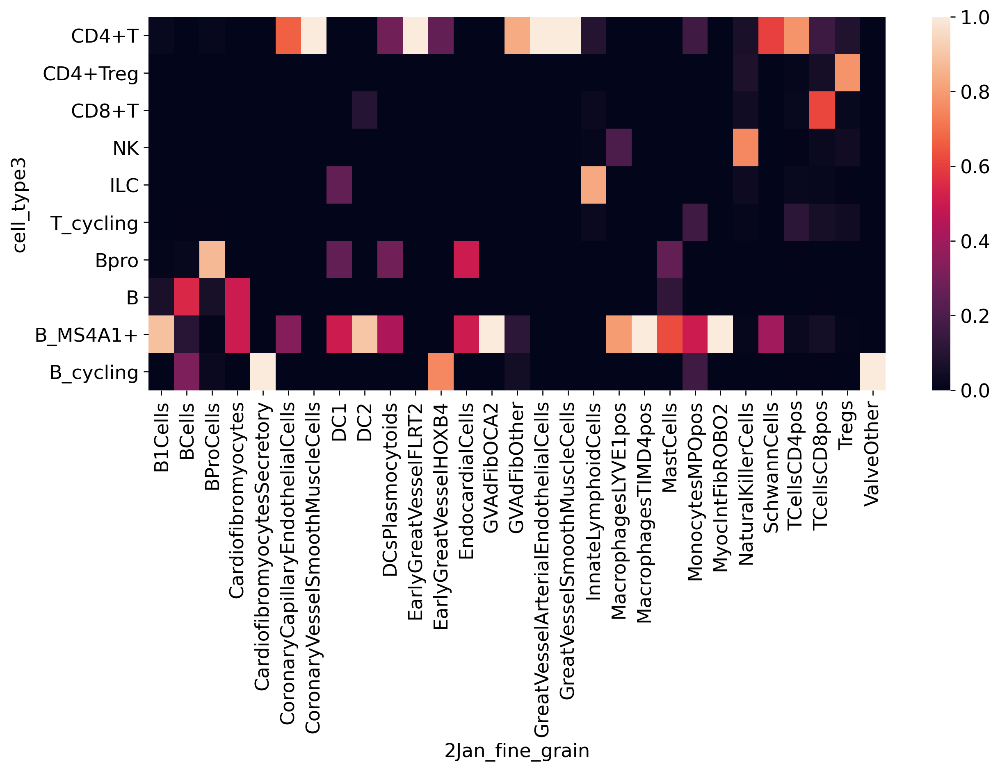

In [90]:
import seaborn as sns
plt.rcParams['figure.figsize'] = 12,5
df=pd.crosstab(adata.obs['cell_type3'],adata.obs['2Jan_fine_grain'],normalize='columns')
sns.heatmap(df)

<AxesSubplot:xlabel='2Jan_fine_grain', ylabel='cell_type3'>

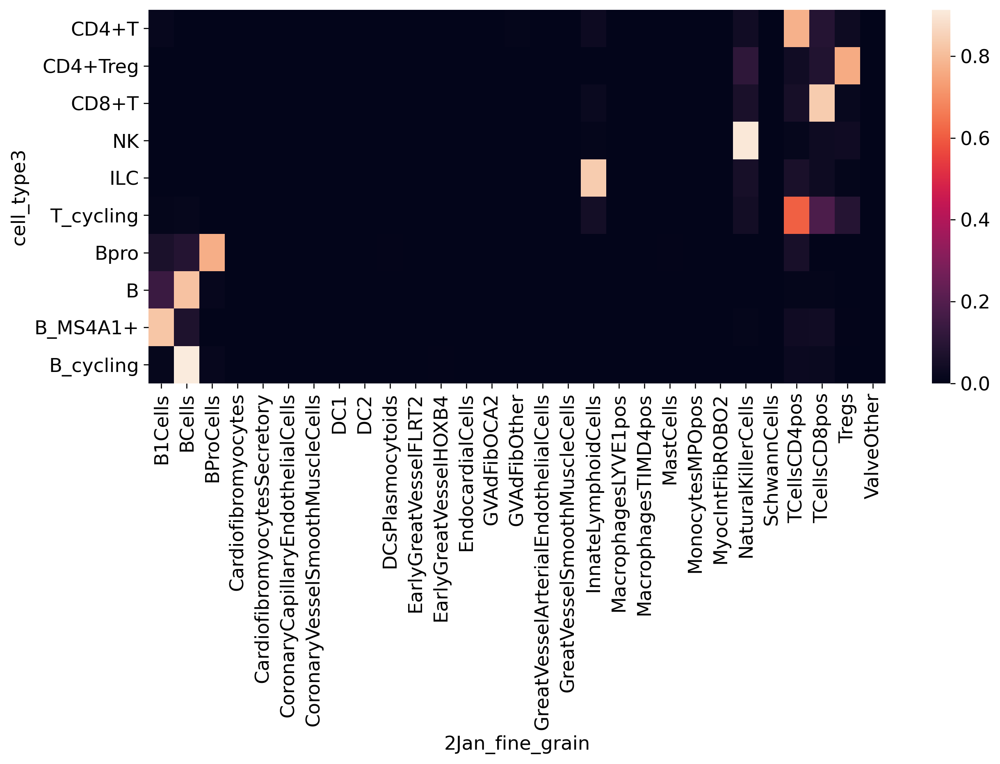

In [89]:
import seaborn as sns
plt.rcParams['figure.figsize'] = 12,5
ad=adata[adata.obs['2Jan_fine_grain']!='nan']
df=pd.crosstab(ad.obs['cell_type3'],ad.obs['2Jan_fine_grain'],normalize='index')
sns.heatmap(df)